##### Copyright 2021 The TensorFlow Hub Authors.

Licensed under the Apache License, Version 2.0 (the "License");

In [57]:
# Copyright 2021 The TensorFlow Hub Authors. All Rights Reserved.
#
# Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
#     http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.
# ==============================================================================

# Image Classification with TensorFlow Hub

In this colab, you'll try multiple image classification models from TensorFlow Hub and decide which one is best for your use case.

Because TF Hub encourages a [consistent input convention](https://www.tensorflow.org/hub/common_saved_model_apis/images#image_input) for models that operate on images, it's easy to experiment with different architectures to find the one that best fits your needs.

In [58]:
import tensorflow as tf
import tensorflow_hub as hub

import requests
from PIL import Image
from io import BytesIO

import matplotlib.pyplot as plt
import numpy as np

import os

In [59]:
#@title Helper functions for loading image (hidden)

original_image_cache = {}

def preprocess_image(image):
  image = np.array(image)
  # reshape into shape [batch_size, height, width, num_channels]
  img_reshaped = tf.reshape(image, [1, image.shape[0], image.shape[1], image.shape[2]])
  # Use `convert_image_dtype` to convert to floats in the [0,1] range.
  image = tf.image.convert_image_dtype(img_reshaped, tf.float32)
  return image

def load_image_from_url(img_url):
  """Returns an image with shape [1, height, width, num_channels]."""
  user_agent = {'User-agent': 'Colab Sample (https://tensorflow.org)'}
  response = requests.get(img_url, headers=user_agent)
  image = Image.open(BytesIO(response.content))
  image = preprocess_image(image)
  return image

def load_image(image_url, image_size=256, dynamic_size=False, max_dynamic_size=512):
  """Loads and preprocesses images."""
  # Cache image file locally.
  if image_url in original_image_cache:
    img = original_image_cache[image_url]
  elif image_url.startswith('https://'):
    img = load_image_from_url(image_url)
  else:
    fd = tf.io.gfile.GFile(image_url, 'rb')
    img = preprocess_image(Image.open(fd))
  original_image_cache[image_url] = img
  # Load and convert to float32 numpy array, add batch dimension, and normalize to range [0, 1].
  img_raw = img
  if tf.reduce_max(img) > 1.0:
    img = img / 255.
  if len(img.shape) == 3:
    img = tf.stack([img, img, img], axis=-1)
  if not dynamic_size:
    img = tf.image.resize_with_pad(img, image_size, image_size)
  elif img.shape[1] > max_dynamic_size or img.shape[2] > max_dynamic_size:
    img = tf.image.resize_with_pad(img, max_dynamic_size, max_dynamic_size)
  return img, img_raw

def show_image(image, title=''):
  image_size = image.shape[1]
  w = (image_size * 6) // 320
  plt.figure(figsize=(w, w))
  plt.imshow(image[0], aspect='equal')
  plt.axis('off')
  plt.title(title)
  plt.show()

Select an Image Classification Model. After that, some internal variables are set and the labels file is downloaded and prepared for use.

There are some technical differences between the models, like different input size, model size, accuracy, and inference time. Here you can change the model you are using until you find the one most suitable for your use case.

The handle (url) of the model is printed for your convenience. More documentation about each model is available there.

Note: All these models were trained on the ImageNet dataset

In [60]:
#@title Select an Image Classification model

image_size = 224
dynamic_size = False

model_name = "efficientnetv2-b3-21k-ft1k" # @param ['efficientnetv2-s', 'efficientnetv2-m', 'efficientnetv2-l', 'efficientnetv2-s-21k', 'efficientnetv2-m-21k', 'efficientnetv2-l-21k', 'efficientnetv2-xl-21k', 'efficientnetv2-b0-21k', 'efficientnetv2-b1-21k', 'efficientnetv2-b2-21k', 'efficientnetv2-b3-21k', 'efficientnetv2-s-21k-ft1k', 'efficientnetv2-m-21k-ft1k', 'efficientnetv2-l-21k-ft1k', 'efficientnetv2-xl-21k-ft1k', 'efficientnetv2-b0-21k-ft1k', 'efficientnetv2-b1-21k-ft1k', 'efficientnetv2-b2-21k-ft1k', 'efficientnetv2-b3-21k-ft1k', 'efficientnetv2-b0', 'efficientnetv2-b1', 'efficientnetv2-b2', 'efficientnetv2-b3', 'efficientnet_b0', 'efficientnet_b1', 'efficientnet_b2', 'efficientnet_b3', 'efficientnet_b4', 'efficientnet_b5', 'efficientnet_b6', 'efficientnet_b7', 'bit_s-r50x1', 'inception_v3', 'inception_resnet_v2', 'resnet_v1_50', 'resnet_v1_101', 'resnet_v1_152', 'resnet_v2_50', 'resnet_v2_101', 'resnet_v2_152', 'nasnet_large', 'nasnet_mobile', 'pnasnet_large', 'mobilenet_v2_100_224', 'mobilenet_v2_130_224', 'mobilenet_v2_140_224', 'mobilenet_v3_small_100_224', 'mobilenet_v3_small_075_224', 'mobilenet_v3_large_100_224', 'mobilenet_v3_large_075_224']

model_handle_map = {
  "efficientnetv2-s": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_s/classification/2",
  "efficientnetv2-m": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_m/classification/2",
  "efficientnetv2-l": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_l/classification/2",
  "efficientnetv2-s-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_s/classification/2",
  "efficientnetv2-m-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_m/classification/2",
  "efficientnetv2-l-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_l/classification/2",
  "efficientnetv2-xl-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_xl/classification/2",
  "efficientnetv2-b0-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b0/classification/2",
  "efficientnetv2-b1-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b1/classification/2",
  "efficientnetv2-b2-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b2/classification/2",
  "efficientnetv2-b3-21k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_b3/classification/2",
  "efficientnetv2-s-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_s/classification/2",
  "efficientnetv2-m-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_m/classification/2",
  "efficientnetv2-l-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_l/classification/2",
  "efficientnetv2-xl-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_xl/classification/2",
  "efficientnetv2-b0-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b0/classification/2",
  "efficientnetv2-b1-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b1/classification/2",
  "efficientnetv2-b2-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b2/classification/2",
  "efficientnetv2-b3-21k-ft1k": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b3/classification/2",
  "efficientnetv2-b0": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b0/classification/2",
  "efficientnetv2-b1": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b1/classification/2",
  "efficientnetv2-b2": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b2/classification/2",
  "efficientnetv2-b3": "https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet1k_b3/classification/2",
  "efficientnet_b0": "https://tfhub.dev/tensorflow/efficientnet/b0/classification/1",
  "efficientnet_b1": "https://tfhub.dev/tensorflow/efficientnet/b1/classification/1",
  "efficientnet_b2": "https://tfhub.dev/tensorflow/efficientnet/b2/classification/1",
  "efficientnet_b3": "https://tfhub.dev/tensorflow/efficientnet/b3/classification/1",
  "efficientnet_b4": "https://tfhub.dev/tensorflow/efficientnet/b4/classification/1",
  "efficientnet_b5": "https://tfhub.dev/tensorflow/efficientnet/b5/classification/1",
  "efficientnet_b6": "https://tfhub.dev/tensorflow/efficientnet/b6/classification/1",
  "efficientnet_b7": "https://tfhub.dev/tensorflow/efficientnet/b7/classification/1",
  "bit_s-r50x1": "https://tfhub.dev/google/bit/s-r50x1/ilsvrc2012_classification/1",
  "inception_v3": "https://tfhub.dev/google/imagenet/inception_v3/classification/4",
  "inception_resnet_v2": "https://tfhub.dev/google/imagenet/inception_resnet_v2/classification/4",
  "resnet_v1_50": "https://tfhub.dev/google/imagenet/resnet_v1_50/classification/4",
  "resnet_v1_101": "https://tfhub.dev/google/imagenet/resnet_v1_101/classification/4",
  "resnet_v1_152": "https://tfhub.dev/google/imagenet/resnet_v1_152/classification/4",
  "resnet_v2_50": "https://tfhub.dev/google/imagenet/resnet_v2_50/classification/4",
  "resnet_v2_101": "https://tfhub.dev/google/imagenet/resnet_v2_101/classification/4",
  "resnet_v2_152": "https://tfhub.dev/google/imagenet/resnet_v2_152/classification/4",
  "nasnet_large": "https://tfhub.dev/google/imagenet/nasnet_large/classification/4",
  "nasnet_mobile": "https://tfhub.dev/google/imagenet/nasnet_mobile/classification/4",
  "pnasnet_large": "https://tfhub.dev/google/imagenet/pnasnet_large/classification/4",
  "mobilenet_v2_100_224": "https://tfhub.dev/google/imagenet/mobilenet_v2_100_224/classification/4",
  "mobilenet_v2_130_224": "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4",
  "mobilenet_v2_140_224": "https://tfhub.dev/google/imagenet/mobilenet_v2_140_224/classification/4",
  "mobilenet_v3_small_100_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_small_100_224/classification/5",
  "mobilenet_v3_small_075_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_small_075_224/classification/5",
  "mobilenet_v3_large_100_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_large_100_224/classification/5",
  "mobilenet_v3_large_075_224": "https://tfhub.dev/google/imagenet/mobilenet_v3_large_075_224/classification/5",
}

model_image_size_map = {
  "efficientnetv2-s": 384,
  "efficientnetv2-m": 480,
  "efficientnetv2-l": 480,
  "efficientnetv2-b0": 224,
  "efficientnetv2-b1": 240,
  "efficientnetv2-b2": 260,
  "efficientnetv2-b3": 300,
  "efficientnetv2-s-21k": 384,
  "efficientnetv2-m-21k": 480,
  "efficientnetv2-l-21k": 480,
  "efficientnetv2-xl-21k": 512,
  "efficientnetv2-b0-21k": 224,
  "efficientnetv2-b1-21k": 240,
  "efficientnetv2-b2-21k": 260,
  "efficientnetv2-b3-21k": 300,
  "efficientnetv2-s-21k-ft1k": 384,
  "efficientnetv2-m-21k-ft1k": 480,
  "efficientnetv2-l-21k-ft1k": 480,
  "efficientnetv2-xl-21k-ft1k": 512,
  "efficientnetv2-b0-21k-ft1k": 224,
  "efficientnetv2-b1-21k-ft1k": 240,
  "efficientnetv2-b2-21k-ft1k": 260,
  "efficientnetv2-b3-21k-ft1k": 300, 
  "efficientnet_b0": 224,
  "efficientnet_b1": 240,
  "efficientnet_b2": 260,
  "efficientnet_b3": 300,
  "efficientnet_b4": 380,
  "efficientnet_b5": 456,
  "efficientnet_b6": 528,
  "efficientnet_b7": 600,
  "inception_v3": 299,
  "inception_resnet_v2": 299,
  "mobilenet_v2_100_224": 224,
  "mobilenet_v2_130_224": 224,
  "mobilenet_v2_140_224": 224,
  "nasnet_large": 331,
  "nasnet_mobile": 224,
  "pnasnet_large": 331,
  "resnet_v1_50": 224,
  "resnet_v1_101": 224,
  "resnet_v1_152": 224,
  "resnet_v2_50": 224,
  "resnet_v2_101": 224,
  "resnet_v2_152": 224,
  "mobilenet_v3_small_100_224": 224,
  "mobilenet_v3_small_075_224": 224,
  "mobilenet_v3_large_100_224": 224,
  "mobilenet_v3_large_075_224": 224,
}

model_handle = model_handle_map[model_name]

print(f"Selected model: {model_name} : {model_handle}")


max_dynamic_size = 512
if model_name in model_image_size_map:
  image_size = model_image_size_map[model_name]
  dynamic_size = False
  print(f"Images will be converted to {image_size}x{image_size}")
else:
  dynamic_size = True
  print(f"Images will be capped to a max size of {max_dynamic_size}x{max_dynamic_size}")

labels_file = "https://storage.googleapis.com/download.tensorflow.org/data/ImageNetLabels.txt"

#download labels and creates a maps
downloaded_file = tf.keras.utils.get_file("labels.txt", origin=labels_file)

classes = []

with open(downloaded_file) as f:
  labels = f.readlines()
  classes = [l.strip() for l in labels]


Selected model: efficientnetv2-b3-21k-ft1k : https://tfhub.dev/google/imagenet/efficientnet_v2_imagenet21k_ft1k_b3/classification/2
Images will be converted to 300x300


In [61]:
# Load images from folder
data_dir = 'images'
image_list = []

# Get rid of those damn .DS_Store files
for root, dirs, files in os.walk(data_dir):
    for name in files:
        if name == '.DS_Store':
            os.remove(os.path.join(root, name))

# Iterate through images dir and add paths to list
for image in os.listdir(data_dir):
    image_list.append(os.path.join(data_dir, image))

Now that the model was chosen, loading it with TensorFlow Hub is simple.

This also calls the model with a random input as a "warmup" run. Subsequent calls are often much faster, and you can compare this with the latency below.

*Note:* models that use a dynamic size might need a fresh "warmup" run for each image size.

In [62]:
classifier = hub.load(model_handle)
image, original_image = load_image(image_list[0], image_size, dynamic_size, max_dynamic_size)

input_shape = image.shape
warmup_input = tf.random.uniform(input_shape, 0, 1.0)
%time warmup_logits = classifier(warmup_input).numpy()

CPU times: user 1.82 s, sys: 134 ms, total: 1.96 s
Wall time: 1.84 s


Everything is ready for inference. Here you can see the top 5 results from the model for the selected image.

CPU times: user 99.8 ms, sys: 14.5 ms, total: 114 ms
Wall time: 104 ms
(1)  975 - geyser: 0.7829853892326355
(2)  981 - volcano: 0.021302325651049614
(3)  852 - television: 0.005137568339705467
(4)  348 - bison: 0.00329449400305748
(5)  641 - manhole cover: 0.002958388300612569


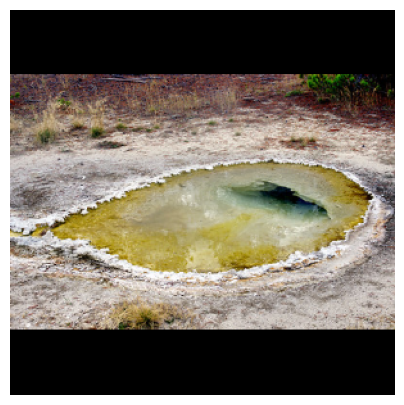

CPU times: user 561 ms, sys: 9.97 ms, total: 571 ms
Wall time: 188 ms
(1)  875 - trolleybus: 0.4810360074043274
(2)  706 - passenger car: 0.38477373123168945
(3)  780 - school bus: 0.010199503973126411
(4)  655 - minibus: 0.009538373909890652
(5)  830 - streetcar: 0.0016154242912307382


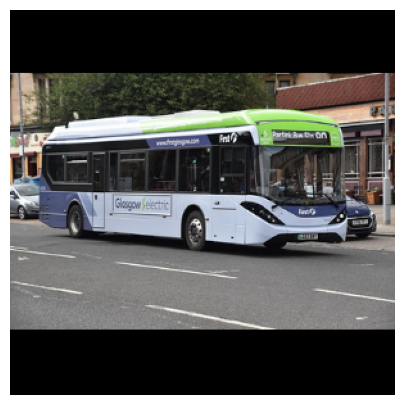

CPU times: user 83 ms, sys: 5.22 ms, total: 88.3 ms
Wall time: 29.4 ms
(1)  858 - throne: 0.4410824775695801
(2)  521 - crib: 0.06579075753688812
(3)  832 - studio couch: 0.0328751802444458
(4)  517 - cradle: 0.0320093035697937
(5)  407 - altar: 0.021609989926218987


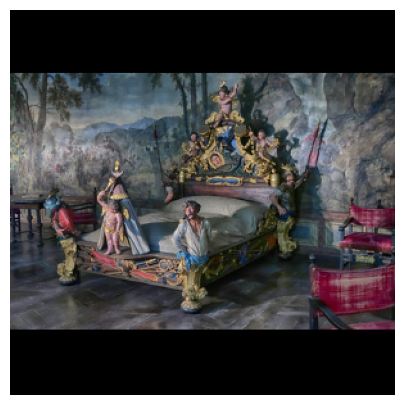

CPU times: user 85.7 ms, sys: 4.58 ms, total: 90.3 ms
Wall time: 28.1 ms
(1)  570 - garbage truck: 0.4221510887145996
(2)  875 - trolleybus: 0.11438778042793274
(3)  408 - ambulance: 0.08892163634300232
(4)  830 - streetcar: 0.0431620217859745
(5)  868 - trailer truck: 0.03116154484450817


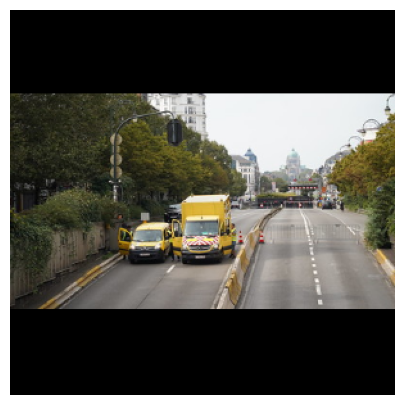

CPU times: user 93 ms, sys: 4.91 ms, total: 97.9 ms
Wall time: 28.6 ms
(1)  651 - microphone: 0.41218724846839905
(2)  820 - stage: 0.1931282877922058
(3)  819 - spotlight: 0.06656622141599655
(4)  777 - sax: 0.025589440017938614
(5)  547 - electric guitar: 0.021649524569511414


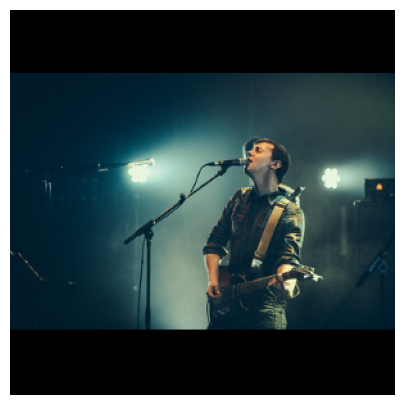

CPU times: user 95 ms, sys: 7.35 ms, total: 102 ms
Wall time: 34 ms
(1)  527 - desk: 0.36297592520713806
(2)  682 - notebook: 0.13763760030269623
(3)  917 - web site: 0.11017457395792007
(4)  554 - file: 0.05717005208134651
(5)  905 - window screen: 0.033633340150117874


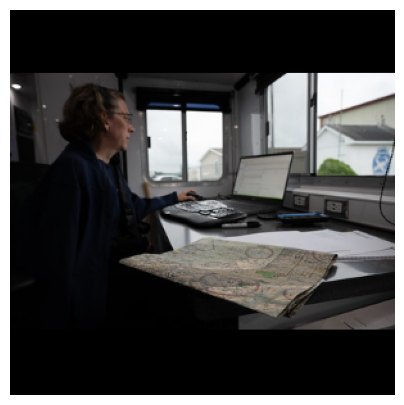

CPU times: user 89.1 ms, sys: 4.87 ms, total: 93.9 ms
Wall time: 28.5 ms
(1)  763 - restaurant: 0.1583651900291443
(2)  560 - folding chair: 0.10193842649459839
(3)  533 - dining table: 0.08332892507314682
(4)  583 - grocery store: 0.037016164511442184
(5)  917 - web site: 0.026170095428824425


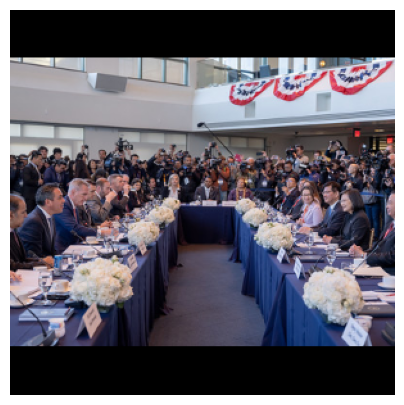

CPU times: user 554 ms, sys: 10.3 ms, total: 565 ms
Wall time: 187 ms
(1)  466 - bulletproof vest: 0.5856558680534363
(2)  462 - breastplate: 0.09631386399269104
(3)  460 - brassiere: 0.0258988905698061
(4)  571 - gasmask: 0.02252977527678013
(5)  434 - bathing cap: 0.01804983802139759


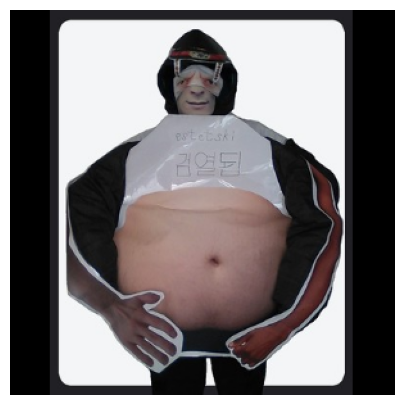

CPU times: user 92.4 ms, sys: 7.91 ms, total: 100 ms
Wall time: 31.1 ms
(1)   99 - red-breasted merganser: 0.4445251226425171
(2)  145 - pelican: 0.18554700911045074
(3)  976 - lakeside: 0.03048960492014885
(4)   98 - drake: 0.020020918920636177
(5)  143 - dowitcher: 0.017539173364639282


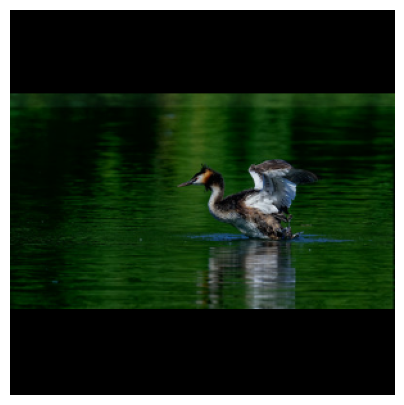

CPU times: user 81.8 ms, sys: 5.55 ms, total: 87.3 ms
Wall time: 27.7 ms
(1)  840 - suspension bridge: 0.4861982464790344
(2)  980 - valley: 0.2711569666862488
(3)  973 - cliff: 0.019813524559140205
(4)  971 - alp: 0.013984551653265953
(5)  977 - promontory: 0.012976497411727905


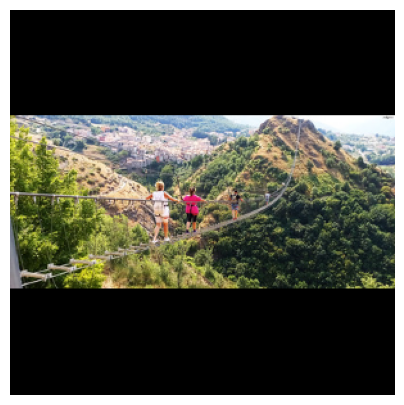

CPU times: user 101 ms, sys: 7.45 ms, total: 109 ms
Wall time: 34.7 ms
(1)  820 - stage: 0.4566380977630615
(2)  782 - scoreboard: 0.08008123934268951
(3)  752 - racer: 0.03909663110971451
(4)  819 - spotlight: 0.025804750621318817
(5)  734 - pole: 0.021935833618044853


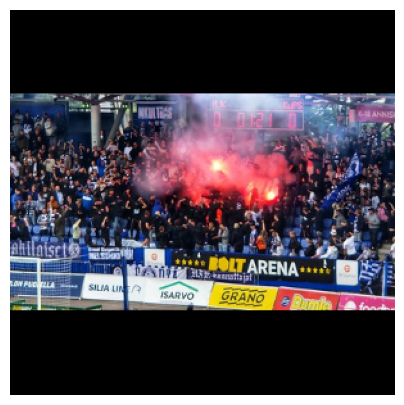

CPU times: user 86.7 ms, sys: 5.96 ms, total: 92.7 ms
Wall time: 28.4 ms
(1)  403 - acoustic guitar: 0.44622981548309326
(2)  904 - wig: 0.12335948646068573
(3)  421 - banjo: 0.03526098281145096
(4)  547 - electric guitar: 0.02211112342774868
(5)  820 - stage: 0.021032337099313736


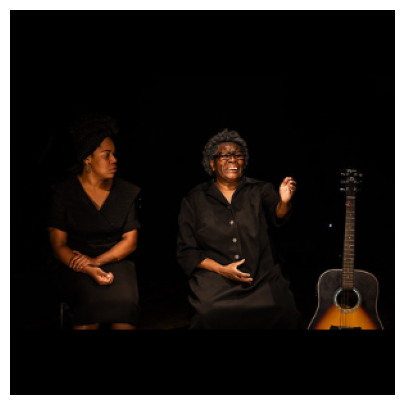

CPU times: user 90 ms, sys: 5.54 ms, total: 95.6 ms
Wall time: 28.8 ms
(1)  405 - airliner: 0.9015019536018372
(2)  909 - wing: 0.015211458317935467
(3)  896 - warplane: 0.004062654450535774
(4)  406 - airship: 0.0020556326489895582
(5)  813 - space shuttle: 0.0005248087691143155


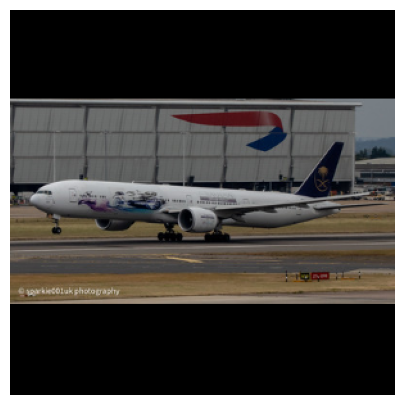

CPU times: user 104 ms, sys: 8 ms, total: 112 ms
Wall time: 33.7 ms
(1)  971 - alp: 0.24910666048526764
(2)  980 - valley: 0.10982287675142288
(3)  526 - dam: 0.07183379679918289
(4)  822 - steel arch bridge: 0.037306707352399826
(5)  914 - wreck: 0.03443652763962746


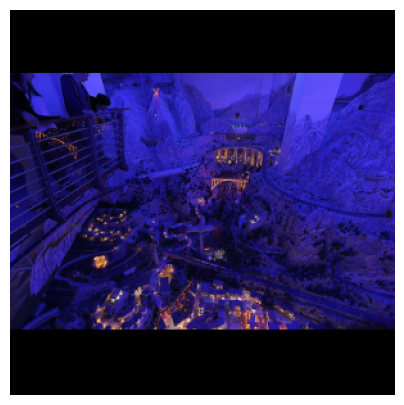

CPU times: user 81.4 ms, sys: 5.54 ms, total: 86.9 ms
Wall time: 27.7 ms
(1)  298 - sloth bear: 0.4490324556827545
(2)  296 - American black bear: 0.39728689193725586
(3)  295 - brown bear: 0.008783896453678608
(4)  297 - ice bear: 0.002930177841335535
(5)  247 - Great Dane: 0.0014524048892781138


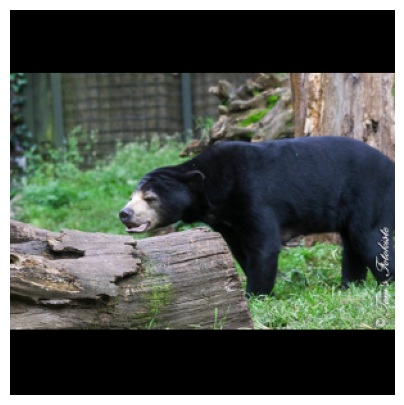

CPU times: user 98.1 ms, sys: 7.26 ms, total: 105 ms
Wall time: 32.4 ms
(1)  566 - freight car: 0.3668520152568817
(2)  868 - trailer truck: 0.04387052357196808
(3)  676 - moving van: 0.038898684084415436
(4)  445 - bicycle-built-for-two: 0.026437383145093918
(5)  792 - shopping cart: 0.025082936510443687


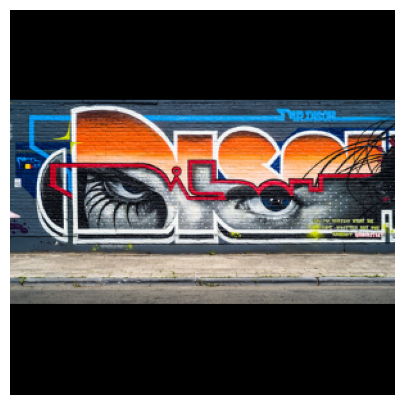

CPU times: user 107 ms, sys: 8.35 ms, total: 116 ms
Wall time: 35.3 ms
(1)  558 - flagpole: 0.18821664154529572
(2)  920 - street sign: 0.17524513602256775
(3)  917 - web site: 0.13436394929885864
(4)  653 - military uniform: 0.05119406431913376
(5)  481 - cash machine: 0.04251888766884804


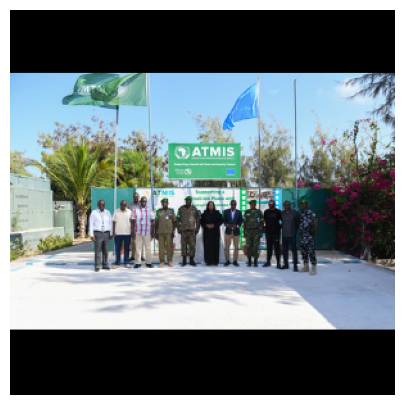

CPU times: user 88.2 ms, sys: 5.96 ms, total: 94.1 ms
Wall time: 30 ms
(1)  481 - cash machine: 0.05359223484992981
(2)  647 - maze: 0.03798149526119232
(3)  761 - refrigerator: 0.03395470976829529
(4)  665 - monitor: 0.021758675575256348
(5)  887 - vending machine: 0.018939321860671043


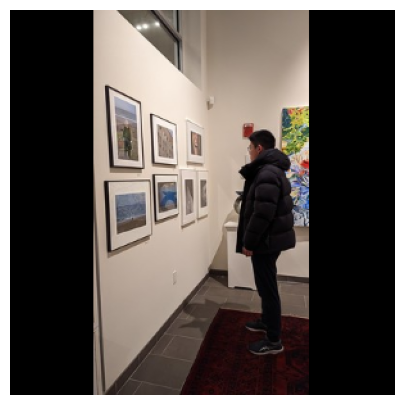

CPU times: user 90.1 ms, sys: 6.12 ms, total: 96.2 ms
Wall time: 29 ms
(1)  611 - jersey: 0.5981647968292236
(2)  420 - Band Aid: 0.02973378822207451
(3)  917 - web site: 0.02267979457974434
(4)  618 - lab coat: 0.014327182434499264
(5)  679 - neck brace: 0.012637515552341938


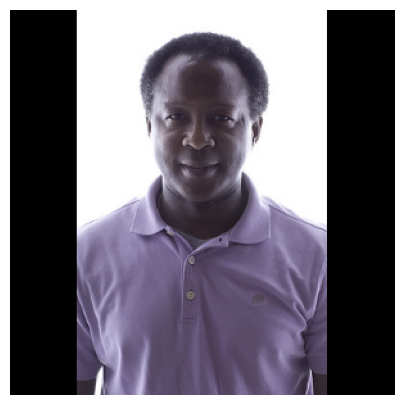

CPU times: user 96.8 ms, sys: 6.17 ms, total: 103 ms
Wall time: 33.1 ms
(1)  980 - valley: 0.22279107570648193
(2)  977 - promontory: 0.17411082983016968
(3)  979 - seashore: 0.12807443737983704
(4)  976 - lakeside: 0.09218066930770874
(5)  526 - dam: 0.029813887551426888


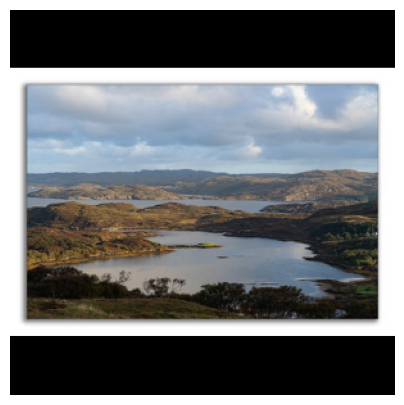

CPU times: user 88.3 ms, sys: 5.44 ms, total: 93.7 ms
Wall time: 28.9 ms
(1)  976 - lakeside: 0.4431544840335846
(2)  979 - seashore: 0.09447062015533447
(3)  977 - promontory: 0.04860712215304375
(4)  781 - schooner: 0.036332715302705765
(5)  485 - catamaran: 0.015289921313524246


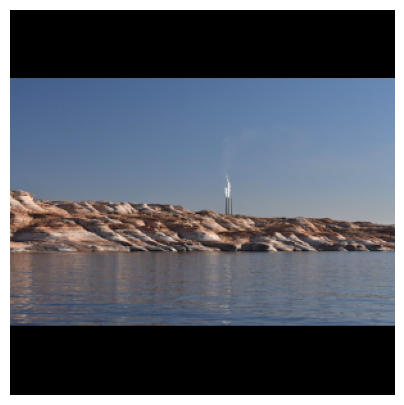

CPU times: user 90.3 ms, sys: 5.24 ms, total: 95.6 ms
Wall time: 29 ms
(1)  295 - brown bear: 0.0674353688955307
(2)   81 - black grouse: 0.058847520500421524
(3)  426 - barn: 0.054644737392663956
(4)  178 - Scottish deerhound: 0.042871907353401184
(5)  209 - Labrador retriever: 0.029499435797333717


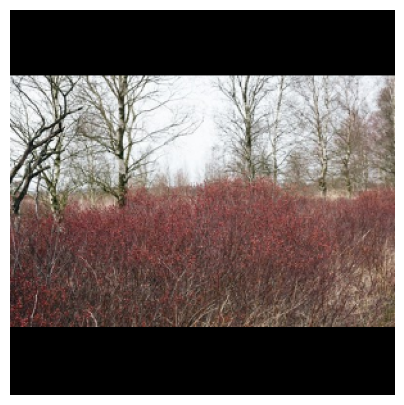

CPU times: user 109 ms, sys: 9.51 ms, total: 119 ms
Wall time: 37.4 ms
(1)  845 - switch: 0.2271413952112198
(2)  692 - oxygen mask: 0.14211757481098175
(3)  687 - oil filter: 0.06983048468828201
(4)  536 - disk brake: 0.06521974503993988
(5)  601 - hook: 0.03449137136340141


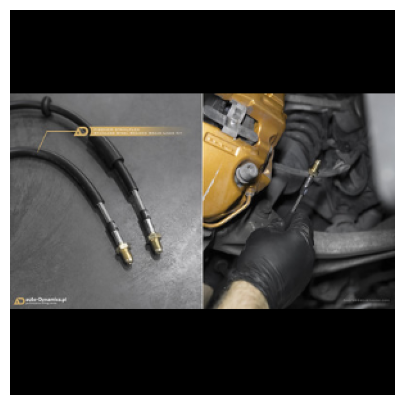

CPU times: user 86.4 ms, sys: 5.48 ms, total: 91.9 ms
Wall time: 28.3 ms
(1)  917 - web site: 0.23850426077842712
(2)  527 - desk: 0.11057274043560028
(3)  852 - television: 0.09930164366960526
(4)  643 - marimba: 0.07144279032945633
(5)  528 - desktop computer: 0.07067206501960754


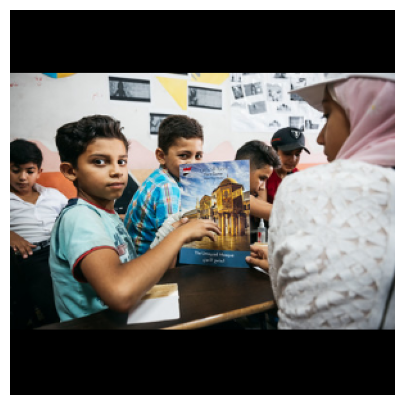

CPU times: user 111 ms, sys: 8.63 ms, total: 120 ms
Wall time: 36.8 ms
(1)  998 - bolete: 0.7711694240570068
(2)  948 - mushroom: 0.0854039341211319
(3)  994 - gyromitra: 0.008449992164969444
(4)  997 - hen-of-the-woods: 0.0035144544672220945
(5)  995 - stinkhorn: 0.0032036020420491695


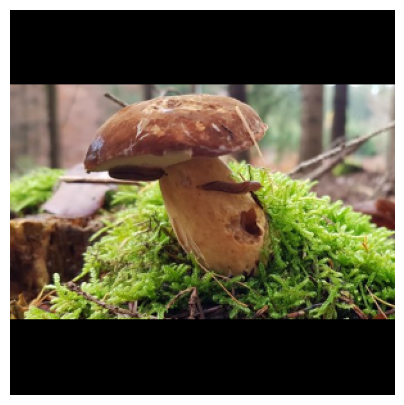

CPU times: user 91.8 ms, sys: 5.6 ms, total: 97.4 ms
Wall time: 30 ms
(1)  979 - seashore: 0.07328027486801147
(2)  365 - three-toed sloth: 0.06093713268637657
(3)  380 - howler monkey: 0.05916370823979378
(4)  955 - banana: 0.04469694569706917
(5)   97 - toucan: 0.030463362112641335


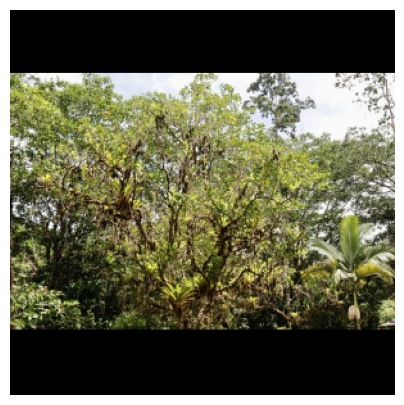

CPU times: user 93.1 ms, sys: 6.89 ms, total: 100 ms
Wall time: 30.8 ms
(1)  976 - lakeside: 0.6149305105209351
(2)  979 - seashore: 0.10547353327274323
(3)  980 - valley: 0.06743456423282623
(4)  526 - dam: 0.0480862520635128
(5)  977 - promontory: 0.010822300799190998


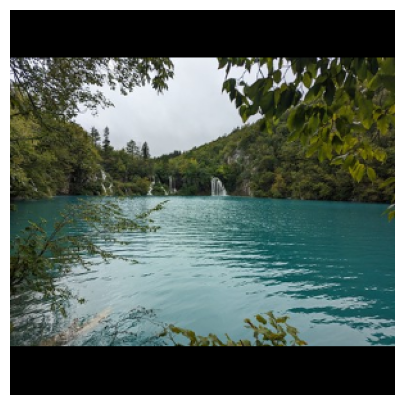

CPU times: user 90.5 ms, sys: 5.98 ms, total: 96.5 ms
Wall time: 28.8 ms
(1)  980 - valley: 0.5747516751289368
(2)  971 - alp: 0.11612100899219513
(3)  981 - volcano: 0.027811840176582336
(4)  973 - cliff: 0.025195153430104256
(5)  977 - promontory: 0.022537626326084137


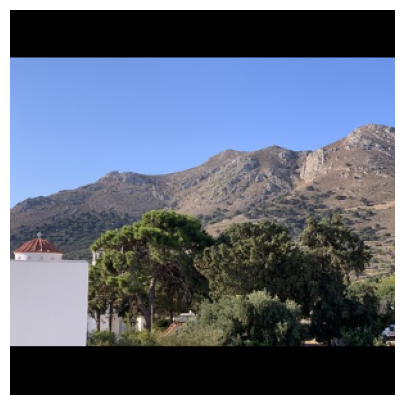

CPU times: user 91.5 ms, sys: 10.6 ms, total: 102 ms
Wall time: 36.3 ms
(1)  436 - bathtub: 0.4219573438167572
(2)  877 - tub: 0.11785069853067398
(3)  897 - washbasin: 0.11204446107149124
(4)  795 - shower curtain: 0.06253380328416824
(5)  649 - medicine chest: 0.02898537926375866


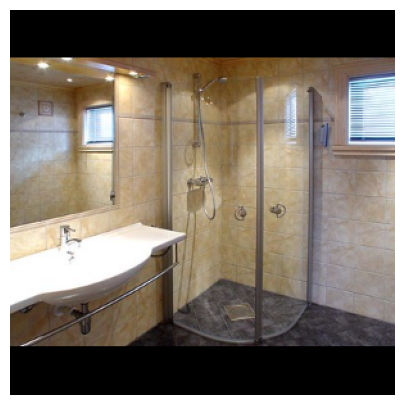

CPU times: user 94.7 ms, sys: 5.83 ms, total: 100 ms
Wall time: 30.2 ms
(1)  820 - stage: 0.30077457427978516
(2)  746 - projector: 0.21919190883636475
(3)  621 - laptop: 0.05714612454175949
(4)  819 - spotlight: 0.037972401827573776
(5)  633 - loudspeaker: 0.03536282479763031


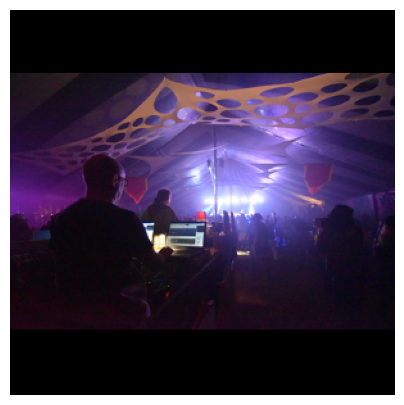

CPU times: user 101 ms, sys: 10.3 ms, total: 111 ms
Wall time: 34 ms
(1)  656 - miniskirt: 0.3539830148220062
(2)  904 - wig: 0.1317104697227478
(3)  807 - sock: 0.030714111402630806
(4)  553 - feather boa: 0.028238054364919662
(5)  837 - sunglass: 0.022399771958589554


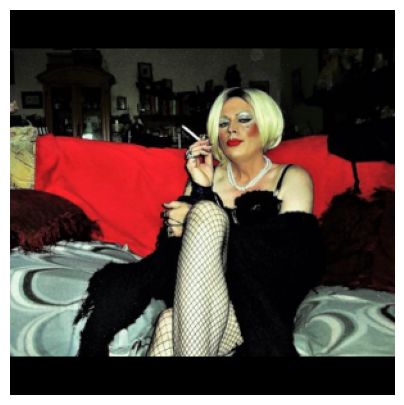

CPU times: user 90.1 ms, sys: 6.02 ms, total: 96.1 ms
Wall time: 29.2 ms
(1)  650 - megalith: 0.8326734304428101
(2)  959 - hay: 0.0010902254143729806
(3)  265 - Cardigan: 0.0009470487711951137
(4)  387 - African elephant: 0.0008945419685915112
(5)  854 - thatch: 0.0008752516587264836


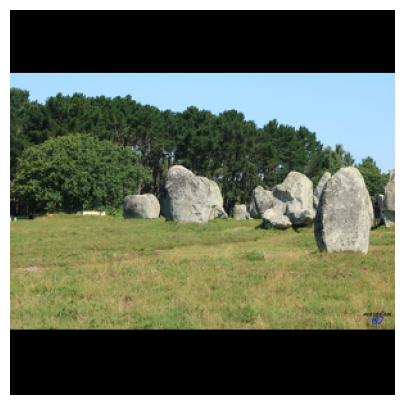

CPU times: user 101 ms, sys: 7.43 ms, total: 108 ms
Wall time: 34.2 ms
(1)  547 - electric guitar: 0.5682656764984131
(2)  403 - acoustic guitar: 0.08462684601545334
(3)  633 - loudspeaker: 0.051632434129714966
(4)  820 - stage: 0.01900811307132244
(5)  421 - banjo: 0.01573578082025051


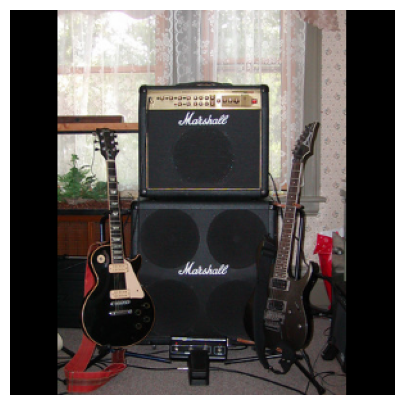

CPU times: user 92.8 ms, sys: 5.72 ms, total: 98.5 ms
Wall time: 29.7 ms
(1)  404 - aircraft carrier: 0.8379111886024475
(2)  541 - drilling platform: 0.031702298671007156
(3)  537 - dock: 0.026428373530507088
(4)  629 - liner: 0.005936287343502045
(5)  834 - submarine: 0.0035425578244030476


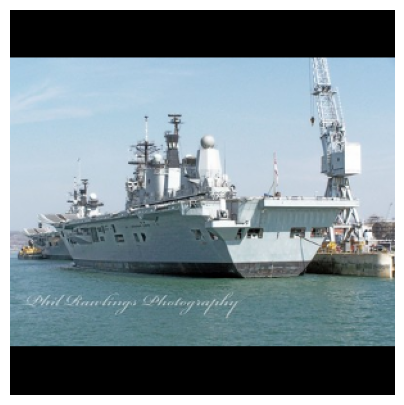

CPU times: user 84.7 ms, sys: 6.27 ms, total: 91 ms
Wall time: 29.1 ms
(1)  973 - cliff: 0.49551767110824585
(2)  980 - valley: 0.23204652965068817
(3)  971 - alp: 0.10185961425304413
(4)  977 - promontory: 0.003215773031115532
(5)  350 - bighorn: 0.003130147699266672


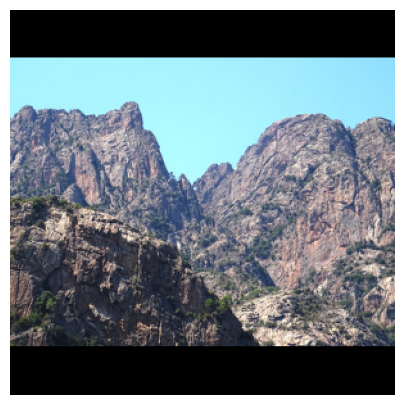

CPU times: user 98.1 ms, sys: 6.75 ms, total: 105 ms
Wall time: 31.9 ms
(1)  661 - mobile home: 0.6258032917976379
(2)  734 - pole: 0.053836237639188766
(3)  572 - gas pump: 0.028951503336429596
(4)  426 - barn: 0.02258480153977871
(5)  875 - trolleybus: 0.021028397604823112


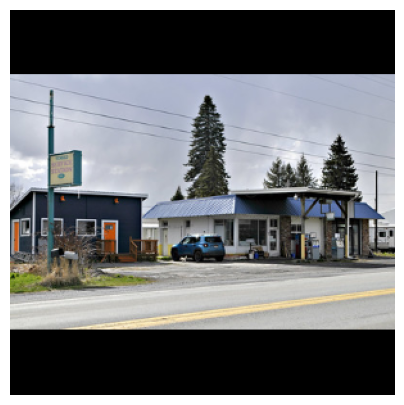

CPU times: user 92.5 ms, sys: 6.27 ms, total: 98.8 ms
Wall time: 30.5 ms
(1)  843 - swimming trunks: 0.4119100868701935
(2)  544 - dumbbell: 0.13503877818584442
(3)  703 - parallel bars: 0.09507541358470917
(4)  423 - barbell: 0.06559909135103226
(5)  460 - brassiere: 0.021068792790174484


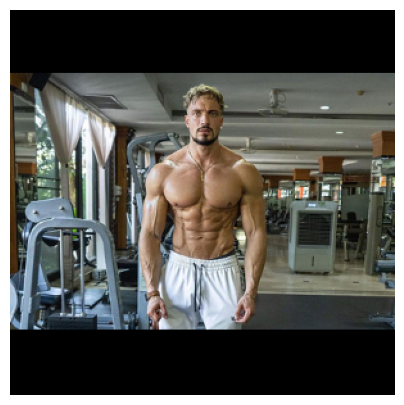

CPU times: user 89.9 ms, sys: 6.4 ms, total: 96.3 ms
Wall time: 29.6 ms
(1)  905 - window screen: 0.884804368019104
(2)  917 - web site: 0.011830784380435944
(3)  906 - window shade: 0.00843982957303524
(4)  527 - desk: 0.0049291993491351604
(5)  447 - binder: 0.0034897455479949713


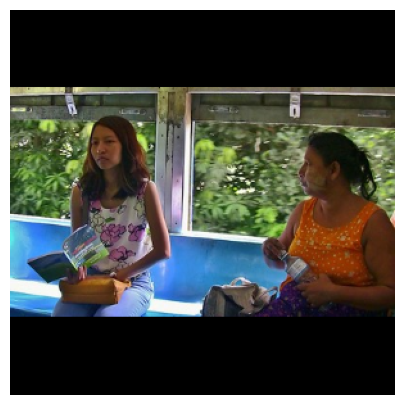

CPU times: user 93.1 ms, sys: 5.93 ms, total: 99 ms
Wall time: 29.8 ms
(1)  683 - obelisk: 0.18619966506958008
(2)  734 - pole: 0.12416228652000427
(3)  558 - flagpole: 0.07166942209005356
(4)  836 - sundial: 0.06762039661407471
(5)  864 - totem pole: 0.032107554376125336


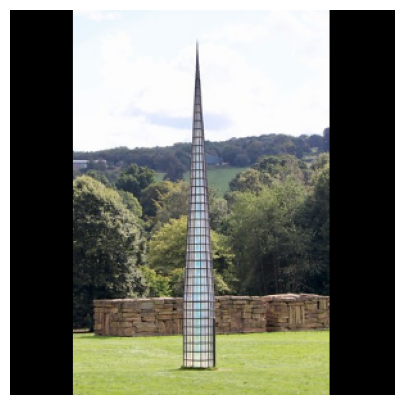

CPU times: user 87.6 ms, sys: 5.42 ms, total: 93.1 ms
Wall time: 29.9 ms
(1)  401 - academic gown: 0.2533143162727356
(2)  668 - mortarboard: 0.20957356691360474
(3)  615 - kimono: 0.18828696012496948
(4)  917 - web site: 0.0335373617708683
(5)  400 - abaya: 0.023125778883695602


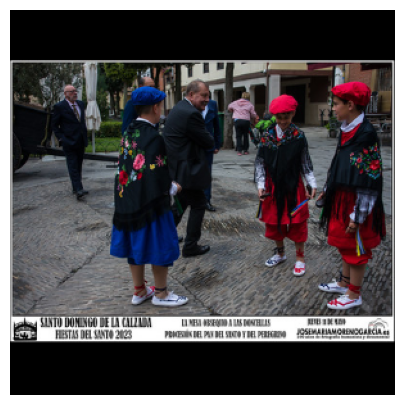

CPU times: user 104 ms, sys: 7.93 ms, total: 112 ms
Wall time: 38 ms
(1)  420 - Band Aid: 0.09511960297822952
(2)  594 - harmonica: 0.06545905768871307
(3)  922 - book jacket: 0.06086841598153114
(4)  700 - panpipe: 0.06059333309531212
(5)  630 - lipstick: 0.04479474946856499


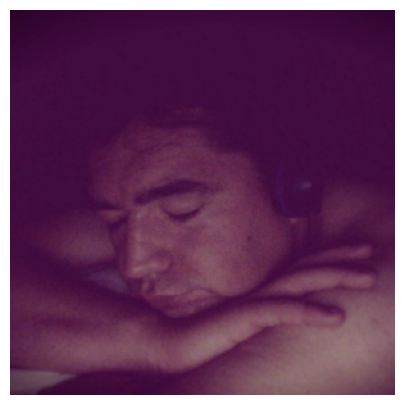

CPU times: user 105 ms, sys: 9.96 ms, total: 115 ms
Wall time: 39.2 ms
(1)  990 - hip: 0.15645402669906616
(2)  320 - dragonfly: 0.08079279959201813
(3)  319 - lacewing: 0.06974790245294571
(4)  996 - earthstar: 0.06617695838212967
(5)  311 - ant: 0.06292526423931122


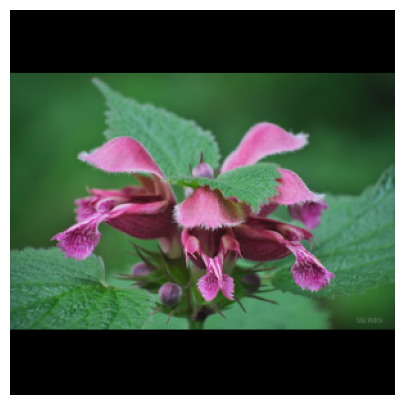

CPU times: user 94.7 ms, sys: 5.97 ms, total: 101 ms
Wall time: 30.6 ms
(1)  975 - geyser: 0.31452029943466187
(2)  985 - rapeseed: 0.29940009117126465
(3)  981 - volcano: 0.10527366399765015
(4)  973 - cliff: 0.04866776242852211
(5)  971 - alp: 0.01672680862247944


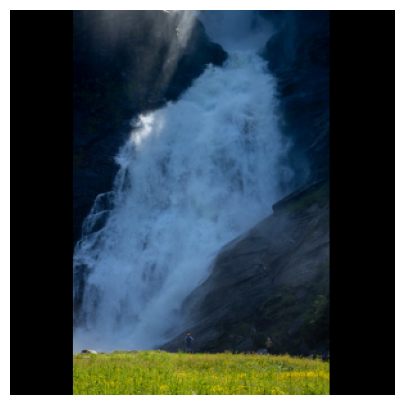

CPU times: user 95.8 ms, sys: 7.1 ms, total: 103 ms
Wall time: 32.5 ms
(1)  921 - traffic light: 0.7744050621986389
(2)  920 - street sign: 0.047700539231300354
(3)  734 - pole: 0.012177187949419022
(4)  830 - streetcar: 0.003998627420514822
(5)  875 - trolleybus: 0.002575226128101349


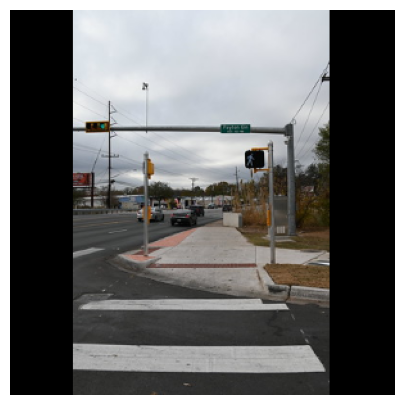

CPU times: user 91.1 ms, sys: 5.78 ms, total: 96.9 ms
Wall time: 30.3 ms
(1)  665 - monitor: 0.22011616826057434
(2)  621 - laptop: 0.18300336599349976
(3)  682 - notebook: 0.150822713971138
(4)  746 - projector: 0.08964775502681732
(5)  783 - screen: 0.032020922750234604


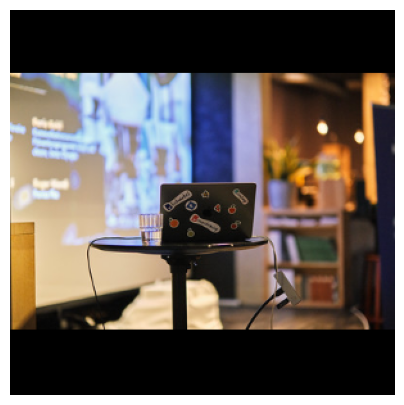

CPU times: user 92.6 ms, sys: 6.9 ms, total: 99.5 ms
Wall time: 30.2 ms
(1)  526 - dam: 0.15968745946884155
(2)  913 - worm fence: 0.11423634737730026
(3)  719 - pier: 0.06541863828897476
(4)  868 - trailer truck: 0.05202097073197365
(5)  422 - bannister: 0.049246735870838165


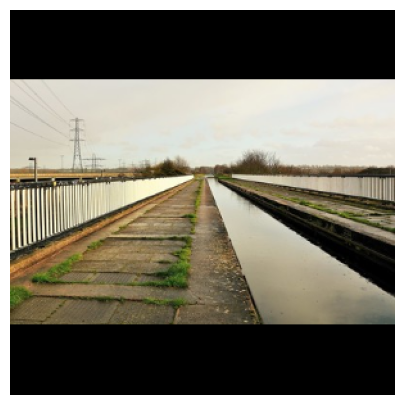

CPU times: user 101 ms, sys: 6.79 ms, total: 108 ms
Wall time: 33.5 ms
(1)  442 - beer glass: 0.1730024367570877
(2)  632 - lotion: 0.1512620896100998
(3)  967 - red wine: 0.09071619063615799
(4)  441 - beer bottle: 0.08047451078891754
(5)  899 - water bottle: 0.05262281000614166


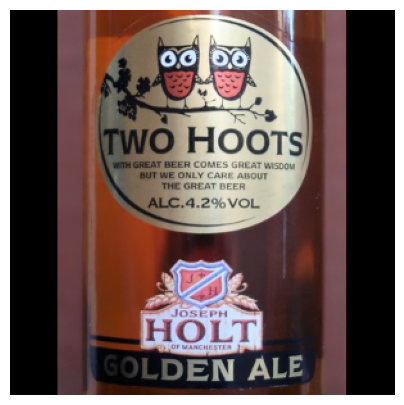

CPU times: user 112 ms, sys: 9.82 ms, total: 122 ms
Wall time: 40.4 ms
(1)  431 - basketball: 0.887377142906189
(2)  891 - volleyball: 0.006274512968957424
(3)  992 - coral fungus: 0.0009095487766899168
(4)  782 - scoreboard: 0.0008950922638177872
(5)  603 - horizontal bar: 0.0006943875341676176


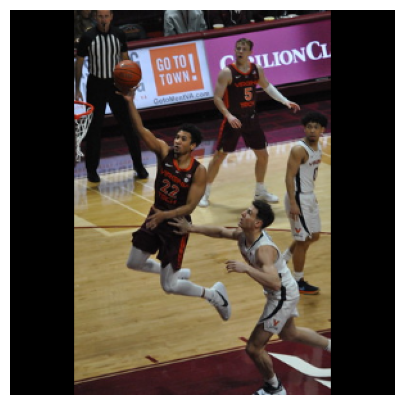

CPU times: user 116 ms, sys: 7.77 ms, total: 124 ms
Wall time: 38.1 ms
(1)  917 - web site: 0.45803871750831604
(2)  550 - envelope: 0.28268060088157654
(3)  693 - packet: 0.052340321242809296
(4)  447 - binder: 0.016993418335914612
(5)  839 - sunscreen: 0.007854882627725601


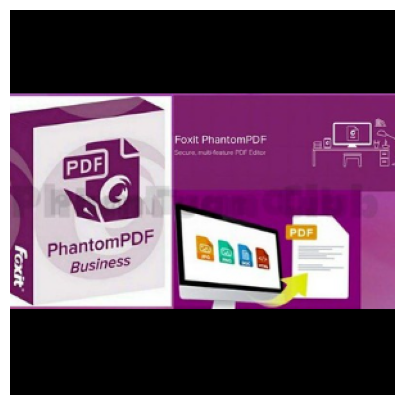

CPU times: user 97.1 ms, sys: 7.73 ms, total: 105 ms
Wall time: 31.4 ms
(1)  416 - bakery: 0.2027863711118698
(2)  861 - tobacco shop: 0.1610518991947174
(3)  455 - bookshop: 0.14732810854911804
(4)  920 - street sign: 0.11888061463832855
(5)  763 - restaurant: 0.03443940356373787


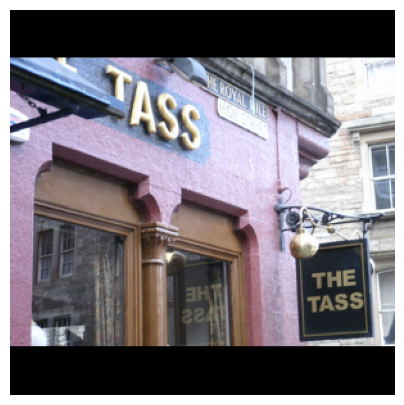

CPU times: user 119 ms, sys: 10 ms, total: 129 ms
Wall time: 40.4 ms
(1)  699 - palace: 0.2906724214553833
(2)  484 - castle: 0.1466994732618332
(3)  498 - church: 0.08885960280895233
(4)  625 - library: 0.06286339461803436
(5)  744 - prison: 0.05909235402941704


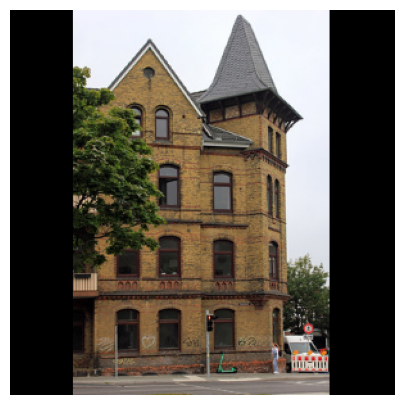

CPU times: user 115 ms, sys: 10.5 ms, total: 125 ms
Wall time: 46.8 ms
(1)  604 - horse cart: 0.22495225071907043
(2)  570 - garbage truck: 0.09463755041360855
(3)  867 - tractor: 0.06599253416061401
(4)  979 - seashore: 0.061909113079309464
(5)  613 - jinrikisha: 0.031767334789037704


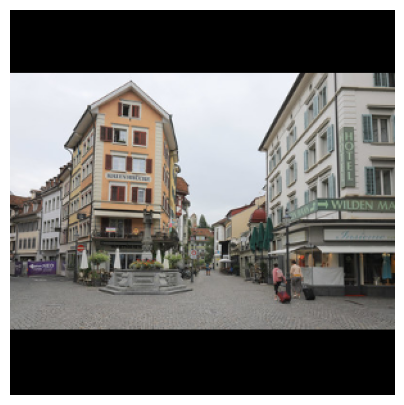

CPU times: user 110 ms, sys: 8.78 ms, total: 118 ms
Wall time: 39.2 ms
(1)  820 - stage: 0.5424313545227051
(2)  584 - guillotine: 0.18536284565925598
(3)  595 - harp: 0.05710454285144806
(4)  499 - cinema: 0.011318404227495193
(5)  917 - web site: 0.008583134971559048


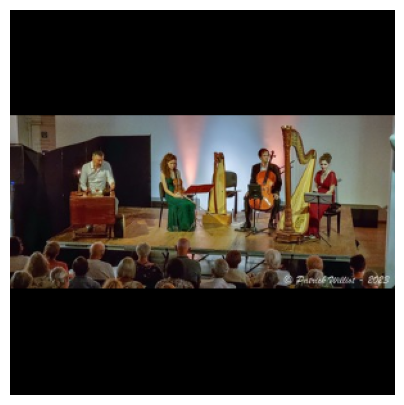

CPU times: user 117 ms, sys: 9.43 ms, total: 127 ms
Wall time: 39.5 ms
(1)  709 - pedestal: 0.522091805934906
(2)  459 - brass: 0.04524032026529312
(3)  525 - cuirass: 0.03951771557331085
(4)  700 - panpipe: 0.038695260882377625
(5)  563 - fountain: 0.018956828862428665


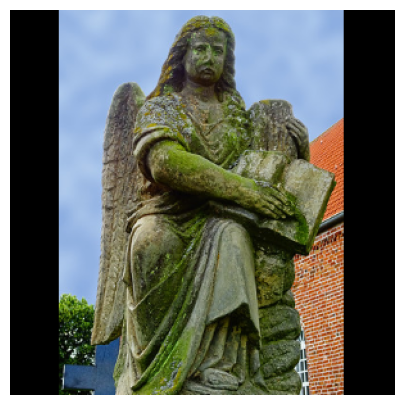

CPU times: user 105 ms, sys: 10 ms, total: 115 ms
Wall time: 36.6 ms
(1)  979 - seashore: 0.09777484834194183
(2)  699 - palace: 0.06190183013677597
(3)  920 - street sign: 0.03667750954627991
(4)  664 - monastery: 0.021532034501433372
(5)  518 - crane: 0.020023193210363388


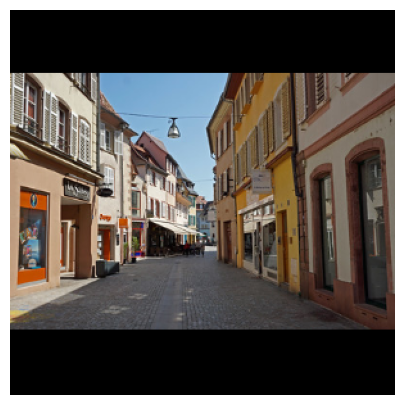

CPU times: user 87.5 ms, sys: 11.9 ms, total: 99.5 ms
Wall time: 36.7 ms
(1)  461 - breakwater: 0.4674789607524872
(2)  526 - dam: 0.04368056729435921
(3)  826 - stone wall: 0.04263972491025925
(4)  566 - freight car: 0.02277359738945961
(5)  635 - lumbermill: 0.02178669348359108


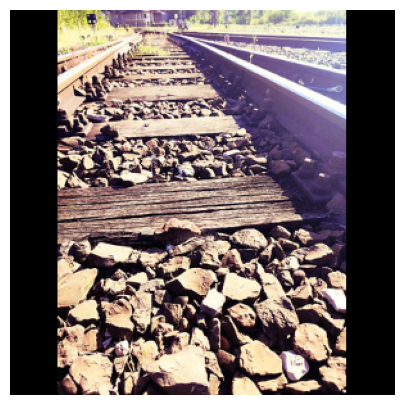

CPU times: user 107 ms, sys: 8.04 ms, total: 115 ms
Wall time: 35.6 ms
(1)  821 - steam locomotive: 0.8700854778289795
(2)  566 - freight car: 0.01812104694545269
(3)  706 - passenger car: 0.008390150032937527
(4)  548 - electric locomotive: 0.0033048216719180346
(5)  867 - tractor: 0.0030570870731025934


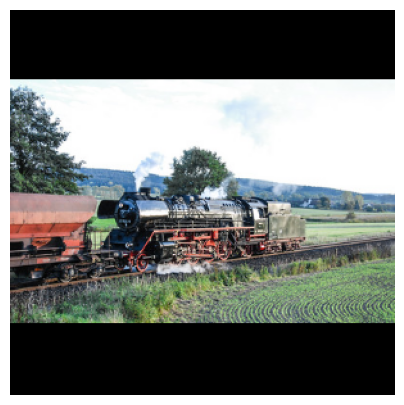

CPU times: user 120 ms, sys: 9.12 ms, total: 129 ms
Wall time: 43 ms
(1)  752 - racer: 0.6147701144218445
(2)  706 - passenger car: 0.11211950331926346
(3)  818 - sports car: 0.0584074966609478
(4)  657 - minivan: 0.012811404652893543
(5)  718 - pickup: 0.010874138213694096


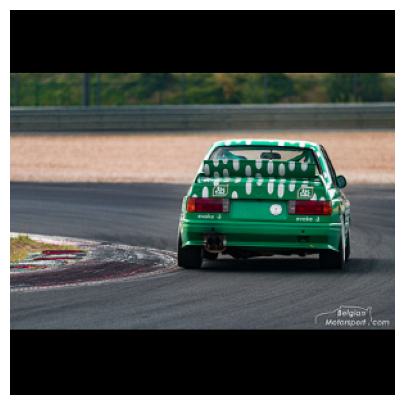

CPU times: user 123 ms, sys: 8.96 ms, total: 132 ms
Wall time: 41.8 ms
(1)  459 - brass: 0.08544661104679108
(2)  413 - ashcan: 0.06843151152133942
(3)  570 - garbage truck: 0.037863489240407944
(4)  673 - mountain tent: 0.03585848584771156
(5)  637 - mailbag: 0.03561331331729889


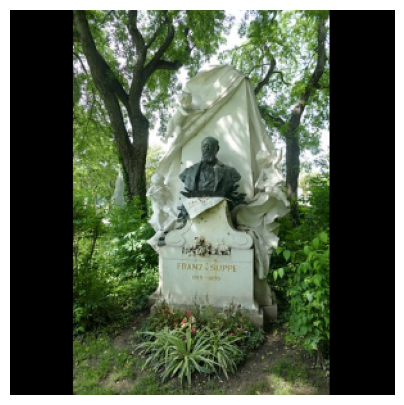

CPU times: user 113 ms, sys: 8.26 ms, total: 121 ms
Wall time: 44.5 ms
(1)  644 - mask: 0.43807661533355713
(2)   40 - common iguana: 0.10761210322380066
(3)   51 - American alligator: 0.08812565356492996
(4)  797 - ski mask: 0.04123749956488609
(5)    3 - great white shark: 0.03875619173049927


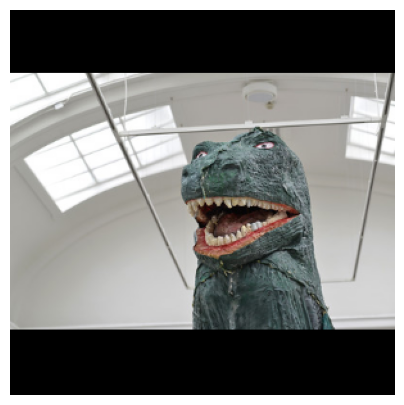

CPU times: user 108 ms, sys: 10.4 ms, total: 118 ms
Wall time: 37.2 ms
(1)  990 - hip: 0.08568732440471649
(2)  991 - buckeye: 0.06443996727466583
(3)  996 - earthstar: 0.03323277831077576
(4)  989 - acorn: 0.017844026908278465
(5)  958 - pomegranate: 0.009974738582968712


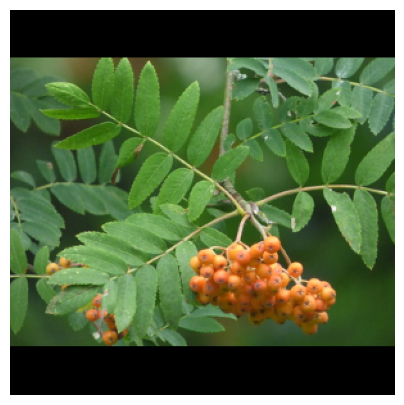

CPU times: user 107 ms, sys: 9.5 ms, total: 117 ms
Wall time: 38.7 ms
(1)  875 - trolleybus: 0.22095760703086853
(2)  655 - minibus: 0.18350103497505188
(3)  780 - school bus: 0.08328639715909958
(4)  570 - garbage truck: 0.0525648295879364
(5)  706 - passenger car: 0.051411841064691544


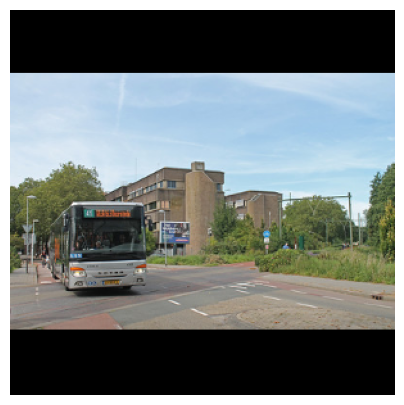

CPU times: user 108 ms, sys: 9.54 ms, total: 117 ms
Wall time: 38.1 ms
(1)  982 - ballplayer: 0.8231298923492432
(2)  430 - baseball: 0.03126835450530052
(3)  782 - scoreboard: 0.010505259037017822
(4)  922 - book jacket: 0.0040732393972575665
(5)  917 - web site: 0.0022553906310349703


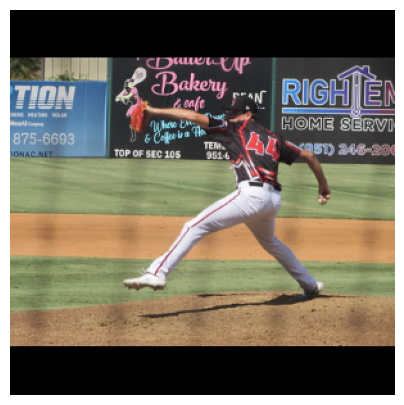

CPU times: user 116 ms, sys: 9.01 ms, total: 125 ms
Wall time: 39.1 ms
(1)  516 - cowboy hat: 0.8126840591430664
(2)  809 - sombrero: 0.0359405092895031
(3)  843 - swimming trunks: 0.0055926828645169735
(4)  452 - bolo tie: 0.0045492565259337425
(5)  515 - cowboy boot: 0.0043318020179867744


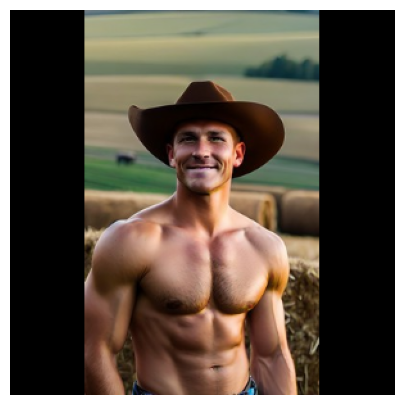

CPU times: user 116 ms, sys: 9.9 ms, total: 126 ms
Wall time: 39.6 ms
(1)  666 - moped: 0.4217371642589569
(2)  519 - crash helmet: 0.0894143357872963
(3)  671 - motor scooter: 0.08512323349714279
(4)  536 - disk brake: 0.05361548438668251
(5)  466 - bulletproof vest: 0.00908537395298481


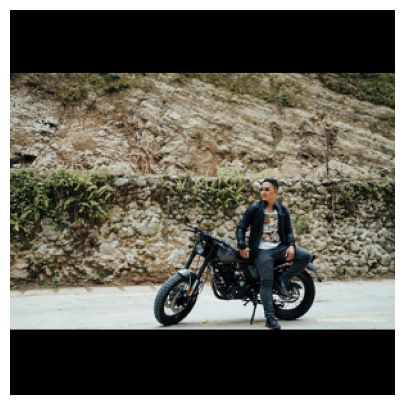

CPU times: user 101 ms, sys: 8.68 ms, total: 110 ms
Wall time: 35.3 ms
(1)  151 - sea lion: 0.8327072858810425
(2)  148 - grey whale: 0.018865633755922318
(3)   35 - leatherback turtle: 0.013078159652650356
(4)  361 - otter: 0.004799779038876295
(5)  297 - ice bear: 0.004755555652081966


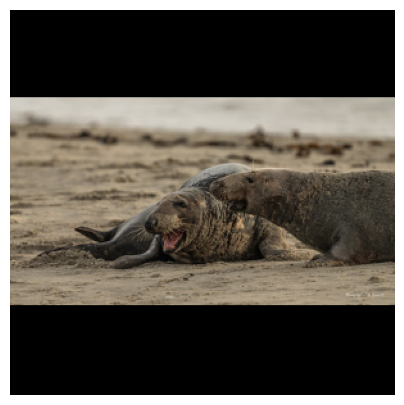

CPU times: user 116 ms, sys: 9.24 ms, total: 125 ms
Wall time: 41 ms
(1)  897 - washbasin: 0.2564612627029419
(2)  805 - soap dispenser: 0.17092108726501465
(3)  917 - web site: 0.0979427844285965
(4)  862 - toilet seat: 0.05904858559370041
(5)  550 - envelope: 0.0398448184132576


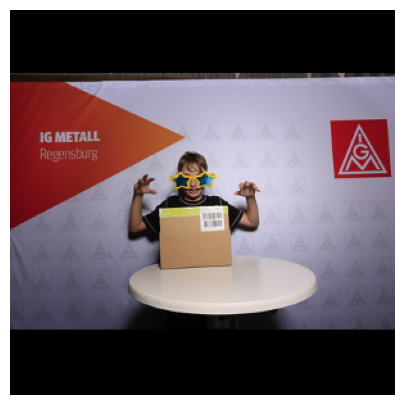

CPU times: user 117 ms, sys: 10.3 ms, total: 127 ms
Wall time: 36.5 ms
(1)  484 - castle: 0.3242431879043579
(2)  973 - cliff: 0.07567941397428513
(3)  438 - beacon: 0.0535212978720665
(4)  977 - promontory: 0.019632039591670036
(5)  664 - monastery: 0.01738186553120613


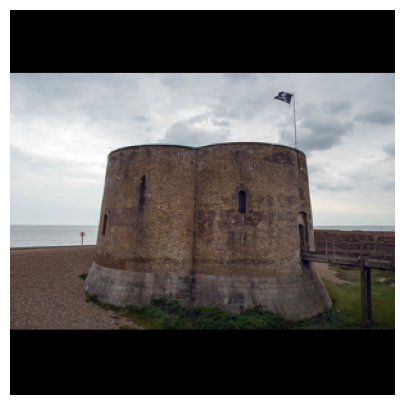

CPU times: user 127 ms, sys: 9.24 ms, total: 137 ms
Wall time: 41.8 ms
(1)  425 - barbershop: 0.24379779398441315
(2)  748 - punching bag: 0.13056345283985138
(3)  838 - sunglasses: 0.04870262369513512
(4)  744 - prison: 0.03435603529214859
(5)  852 - television: 0.027354277670383453


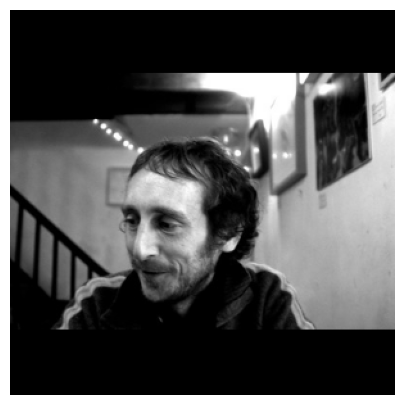

CPU times: user 118 ms, sys: 9.61 ms, total: 127 ms
Wall time: 39.2 ms
(1)  833 - stupa: 0.6806854605674744
(2)  438 - beacon: 0.0639115497469902
(3)  709 - pedestal: 0.05075084790587425
(4)  461 - breakwater: 0.00904012843966484
(5)  683 - obelisk: 0.005958378780633211


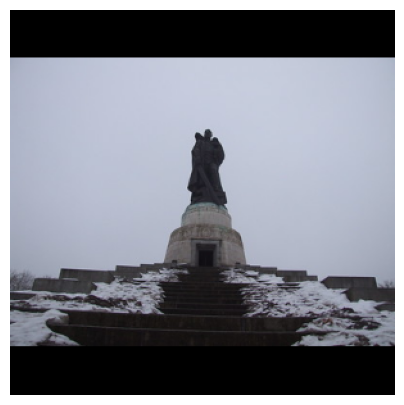

CPU times: user 109 ms, sys: 9.53 ms, total: 119 ms
Wall time: 35.5 ms
(1)  971 - alp: 0.8465497493743896
(2)  980 - valley: 0.09016765654087067
(3)  973 - cliff: 0.004060108680278063
(4)  976 - lakeside: 0.0016246018931269646
(5)  673 - mountain tent: 0.001084561343304813


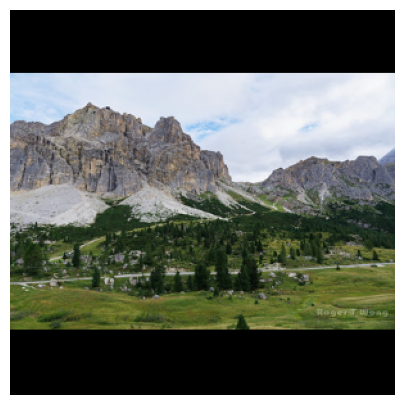

CPU times: user 91.2 ms, sys: 13 ms, total: 104 ms
Wall time: 35.2 ms
(1)  550 - envelope: 0.5989810228347778
(2)  917 - web site: 0.12265736609697342
(3)  645 - matchstick: 0.030973326414823532
(4)  410 - analog clock: 0.023152034729719162
(5)  479 - carton: 0.01792253367602825


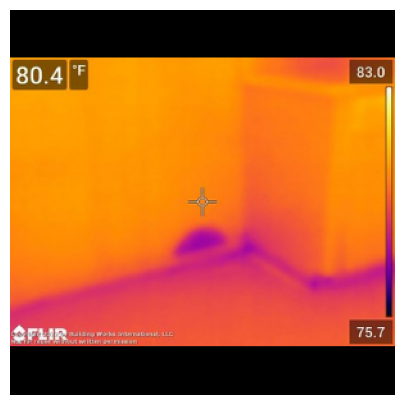

CPU times: user 113 ms, sys: 9.97 ms, total: 123 ms
Wall time: 40.2 ms
(1)  917 - web site: 0.2932073771953583
(2)  643 - marimba: 0.12408185005187988
(3)  401 - academic gown: 0.09067215025424957
(4)  668 - mortarboard: 0.05472221225500107
(5)  704 - park bench: 0.023099500685930252


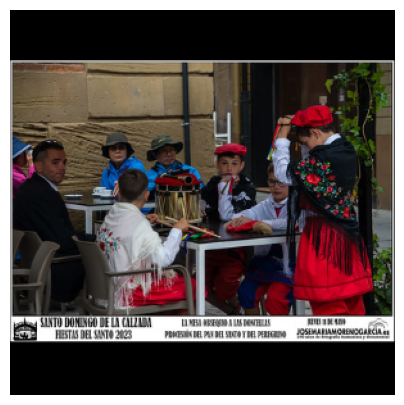

CPU times: user 112 ms, sys: 9.87 ms, total: 122 ms
Wall time: 37.7 ms
(1)  980 - valley: 0.7750744223594666
(2)  971 - alp: 0.0641133263707161
(3)  889 - viaduct: 0.04691436514258385
(4)  826 - stone wall: 0.033112771809101105
(5)  672 - mountain bike: 0.0034025805070996284


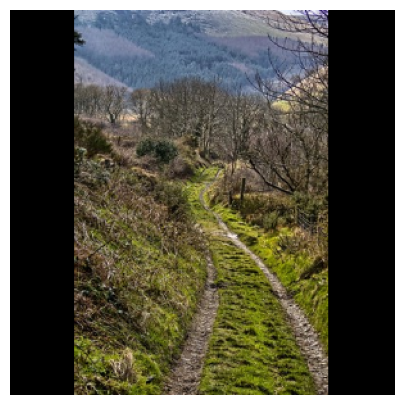

CPU times: user 114 ms, sys: 8.44 ms, total: 123 ms
Wall time: 48.2 ms
(1)  875 - trolleybus: 0.36093229055404663
(2)  548 - electric locomotive: 0.14960433542728424
(3)  830 - streetcar: 0.12011288106441498
(4)  706 - passenger car: 0.06602694094181061
(5)  734 - pole: 0.03391319140791893


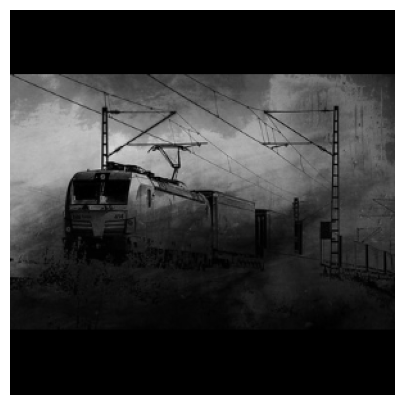

CPU times: user 100 ms, sys: 7.49 ms, total: 108 ms
Wall time: 44.8 ms
(1)  781 - schooner: 0.29622745513916016
(2)  979 - seashore: 0.11823777109384537
(3)  626 - lifeboat: 0.06319234520196915
(4)  815 - speedboat: 0.05192991718649864
(5)  629 - liner: 0.04830218851566315


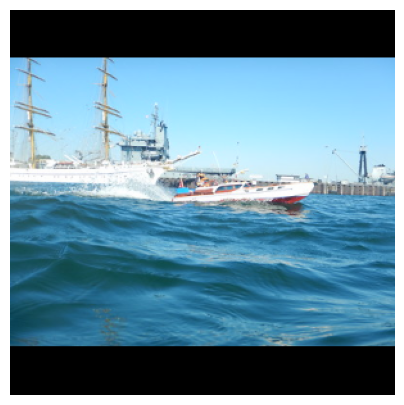

CPU times: user 314 ms, sys: 9.89 ms, total: 323 ms
Wall time: 108 ms
(1)   19 - magpie: 0.8578104972839355
(2)   21 - water ouzel: 0.015342973172664642
(3)   16 - robin: 0.010780115611851215
(4)   81 - black grouse: 0.0028605773113667965
(5)   18 - jay: 0.001977314008399844


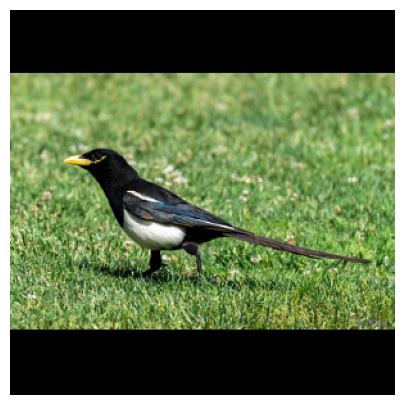

CPU times: user 102 ms, sys: 9.08 ms, total: 111 ms
Wall time: 44.9 ms
(1)  694 - paddle: 0.5732444524765015
(2)  473 - canoe: 0.13593405485153198
(3)  802 - snorkel: 0.02507421188056469
(4)  978 - sandbar: 0.007605212274938822
(5)  434 - bathing cap: 0.007195774931460619


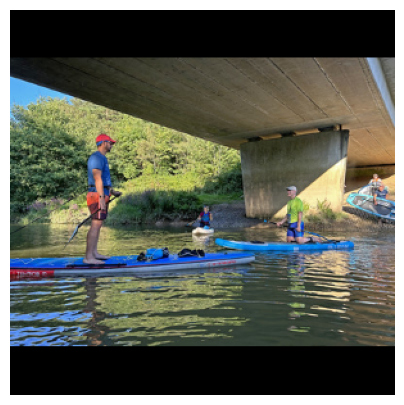

CPU times: user 100 ms, sys: 10.1 ms, total: 110 ms
Wall time: 35.7 ms
(1)  699 - palace: 0.8571971654891968
(2)  484 - castle: 0.005702887661755085
(3)  874 - triumphal arch: 0.005138877313584089
(4)  625 - library: 0.005095123779028654
(5)  512 - convertible: 0.0024521122686564922


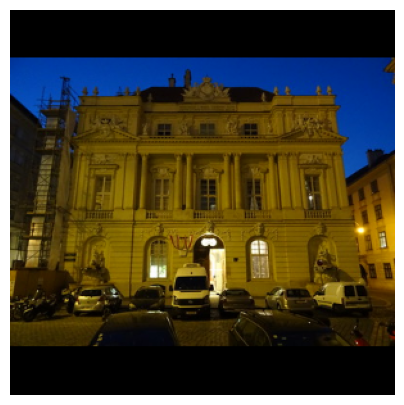

CPU times: user 116 ms, sys: 8.84 ms, total: 125 ms
Wall time: 38.4 ms
(1)  625 - library: 0.5494551658630371
(2)  861 - tobacco shop: 0.10277362167835236
(3)  455 - bookshop: 0.034221746027469635
(4)  905 - window screen: 0.016237756237387657
(5)  454 - bookcase: 0.011505902744829655


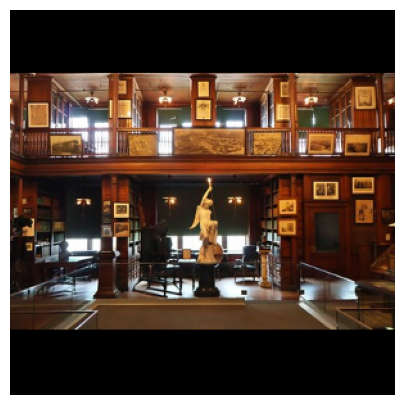

CPU times: user 110 ms, sys: 9.54 ms, total: 119 ms
Wall time: 37.9 ms
(1)  131 - flamingo: 0.9425919055938721
(2)  130 - spoonbill: 0.003145112656056881
(3)  133 - American egret: 0.0011725464137271047
(4)  100 - goose: 0.0007346637430600822
(5)  135 - crane: 0.0006763103301636875


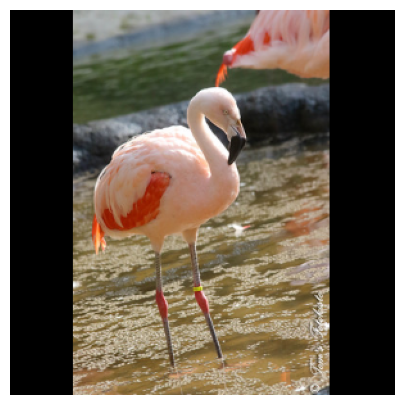

CPU times: user 114 ms, sys: 8.8 ms, total: 123 ms
Wall time: 37.7 ms
(1)  971 - alp: 0.7843001484870911
(2)  973 - cliff: 0.06669389456510544
(3)  980 - valley: 0.04880323261022568
(4)  351 - ibex: 0.007088507525622845
(5)  977 - promontory: 0.006923262495547533


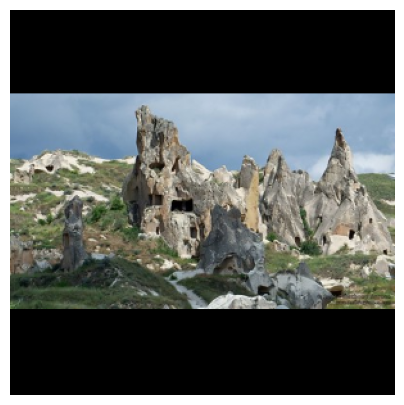

CPU times: user 109 ms, sys: 9.79 ms, total: 119 ms
Wall time: 38.7 ms
(1)  501 - cliff dwelling: 0.46131762862205505
(2)  516 - cowboy hat: 0.15693624317646027
(3)  973 - cliff: 0.07263824343681335
(4)  980 - valley: 0.03975459560751915
(5)  978 - sandbar: 0.03015902452170849


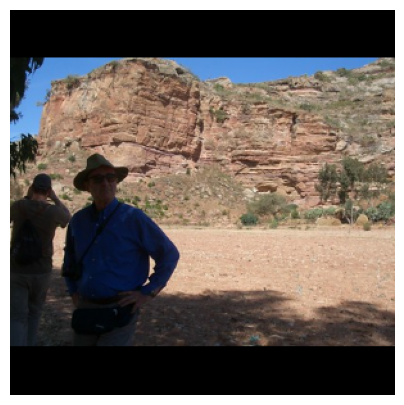

CPU times: user 82.5 ms, sys: 11.2 ms, total: 93.7 ms
Wall time: 36.4 ms
(1)  112 - nematode: 0.1199093833565712
(2)  600 - honeycomb: 0.05381665751338005
(3)  420 - Band Aid: 0.049791570752859116
(4)  931 - French loaf: 0.028853613883256912
(5)  988 - corn: 0.025561580434441566


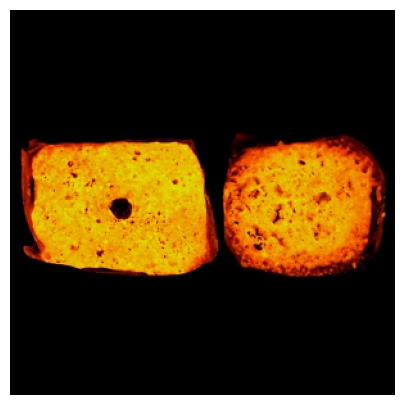

CPU times: user 103 ms, sys: 10.3 ms, total: 113 ms
Wall time: 38.1 ms
(1)  434 - bathing cap: 0.7447159290313721
(2)  843 - swimming trunks: 0.025562159717082977
(3)  802 - snorkel: 0.00587616628035903
(4)  640 - maillot: 0.005381389055401087
(5)  794 - shower cap: 0.005164510570466518


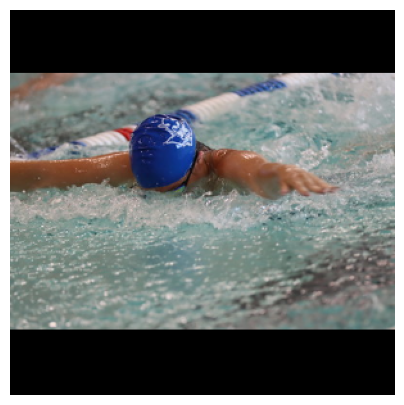

CPU times: user 128 ms, sys: 9.13 ms, total: 137 ms
Wall time: 43.1 ms
(1)  699 - palace: 0.8712341785430908
(2)  484 - castle: 0.03627587854862213
(3)  905 - window screen: 0.010237514041364193
(4)  443 - bell cote: 0.0053723519667983055
(5)  625 - library: 0.004819351248443127


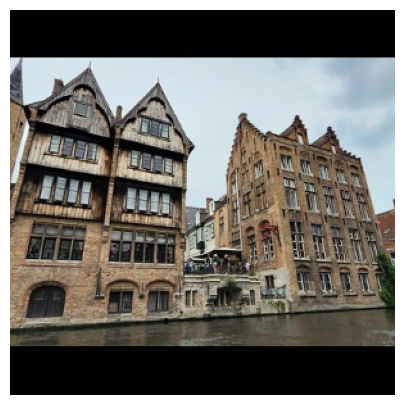

CPU times: user 108 ms, sys: 8.07 ms, total: 116 ms
Wall time: 37.1 ms
(1)  679 - neck brace: 0.08717212080955505
(2)  516 - cowboy hat: 0.051722221076488495
(3)  477 - carousel: 0.0446922592818737
(4)  415 - backpack: 0.041353728622198105
(5)  852 - television: 0.03995724022388458


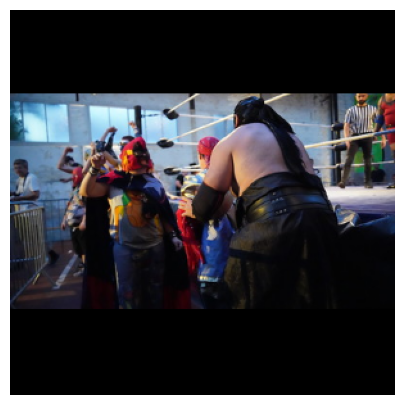

CPU times: user 122 ms, sys: 9.02 ms, total: 131 ms
Wall time: 39.9 ms
(1)  558 - flagpole: 0.7181703448295593
(2)  734 - pole: 0.1981613039970398
(3)  905 - window screen: 0.02479151263833046
(4)  707 - patio: 0.005223324988037348
(5)  920 - street sign: 0.0033867405727505684


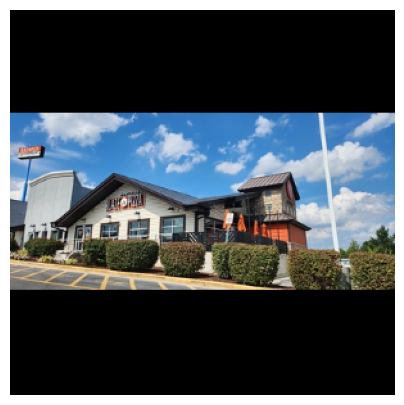

CPU times: user 109 ms, sys: 9.72 ms, total: 119 ms
Wall time: 36.4 ms
(1)  511 - container ship: 0.47687992453575134
(2)  868 - trailer truck: 0.11074621230363846
(3)  917 - web site: 0.04630013182759285
(4)  566 - freight car: 0.04358480125665665
(5)  426 - barn: 0.02105323038995266


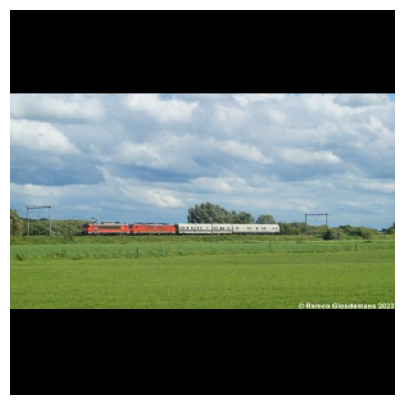

CPU times: user 123 ms, sys: 9.11 ms, total: 132 ms
Wall time: 41.4 ms
(1)  516 - cowboy hat: 0.2790779769420624
(2)  651 - microphone: 0.08119311928749084
(3)  852 - television: 0.06303652375936508
(4)  819 - spotlight: 0.05598783865571022
(5)  642 - maraca: 0.04368463531136513


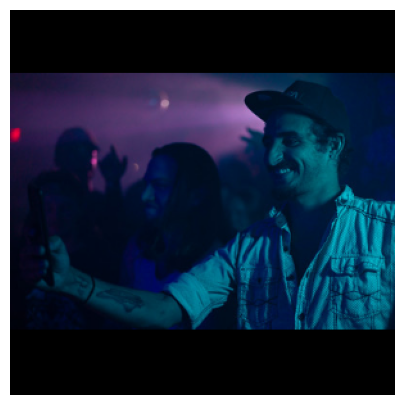

CPU times: user 116 ms, sys: 9.62 ms, total: 126 ms
Wall time: 39.5 ms
(1)  229 - komondor: 0.20981614291667938
(2)  191 - Sealyham terrier: 0.19056683778762817
(3)  204 - West Highland white terrier: 0.10321234166622162
(4)  223 - kuvasz: 0.06323973089456558
(5)  203 - soft-coated wheaten terrier: 0.03785741329193115


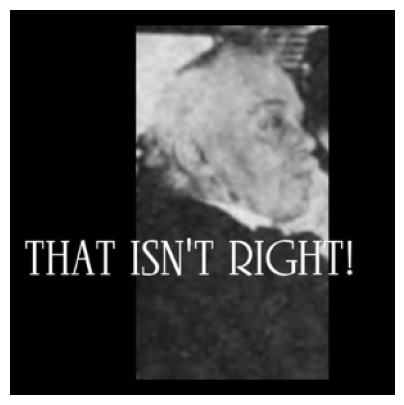

CPU times: user 111 ms, sys: 10 ms, total: 121 ms
Wall time: 35.7 ms
(1)  445 - bicycle-built-for-two: 0.2725684940814972
(2)  666 - moped: 0.2422945201396942
(3)  871 - tricycle: 0.04283381253480911
(4)  671 - motor scooter: 0.03483697399497032
(5)  672 - mountain bike: 0.024619154632091522


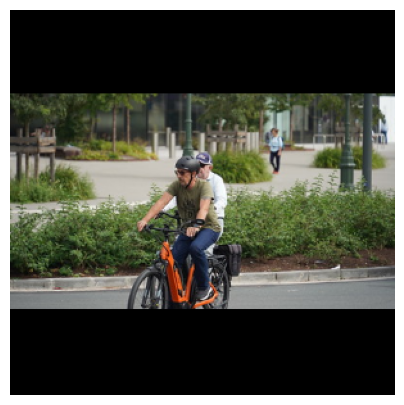

CPU times: user 115 ms, sys: 9.3 ms, total: 124 ms
Wall time: 40.1 ms
(1)  526 - dam: 0.3888133764266968
(2)  840 - suspension bridge: 0.1060882955789566
(3)  980 - valley: 0.07628373056650162
(4)  977 - promontory: 0.04316915199160576
(5)  822 - steel arch bridge: 0.034492578357458115


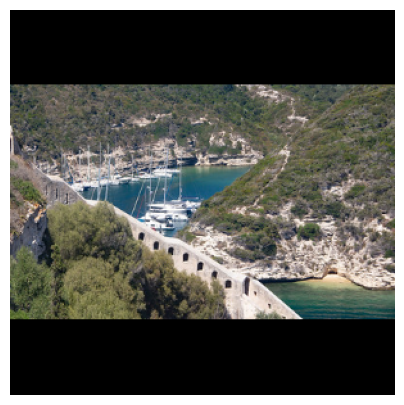

CPU times: user 108 ms, sys: 10.7 ms, total: 119 ms
Wall time: 38.3 ms
(1)  611 - jersey: 0.2744678556919098
(2)  982 - ballplayer: 0.05617084354162216
(3)  753 - racket: 0.04497477039694786
(4)  439 - beaker: 0.041958726942539215
(5)  723 - ping-pong ball: 0.03861062601208687


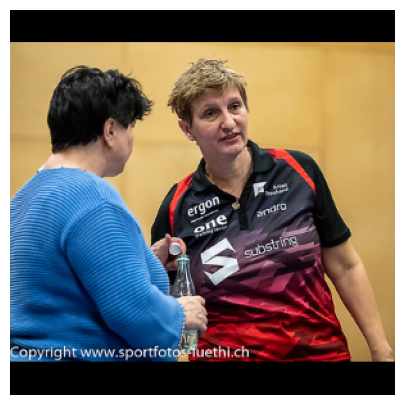

CPU times: user 79.1 ms, sys: 9.94 ms, total: 89 ms
Wall time: 43.3 ms
(1)  471 - candle: 0.3381279408931732
(2)  620 - lampshade: 0.08579088747501373
(3)  585 - hair slide: 0.08264493942260742
(4)  410 - analog clock: 0.05740540102124214
(5)  589 - hamper: 0.05325300246477127


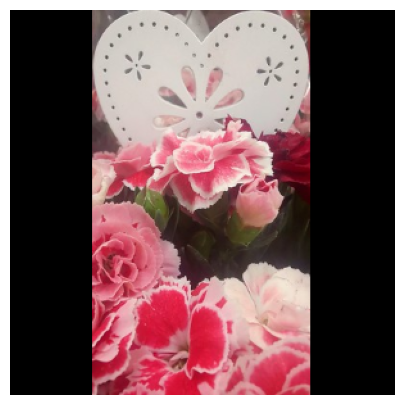

CPU times: user 120 ms, sys: 9.76 ms, total: 130 ms
Wall time: 40 ms
(1)  651 - microphone: 0.21675093472003937
(2)  514 - cornet: 0.061328593641519547
(3)  917 - web site: 0.04888065904378891
(4)  967 - red wine: 0.04581788554787636
(5)  820 - stage: 0.04557419568300247


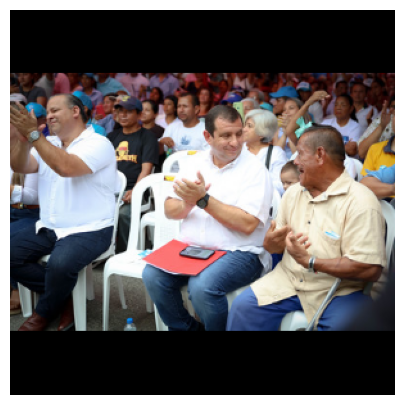

CPU times: user 113 ms, sys: 9 ms, total: 122 ms
Wall time: 36.8 ms
(1)  822 - steel arch bridge: 0.8828080296516418
(2)  719 - pier: 0.01498583797365427
(3)  457 - bow: 0.0024644448421895504
(4)  976 - lakeside: 0.0018749855225905776
(5)  840 - suspension bridge: 0.0013994042528793216


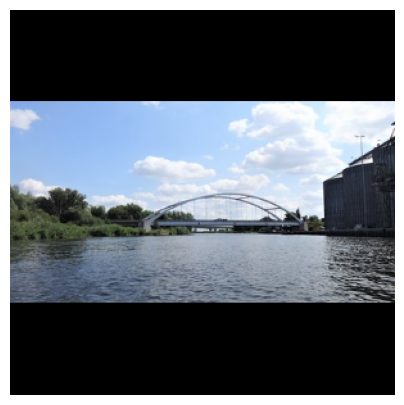

CPU times: user 77.1 ms, sys: 11 ms, total: 88.1 ms
Wall time: 36 ms
(1)  407 - altar: 0.6055017709732056
(2)  885 - vault: 0.142325758934021
(3)  664 - monastery: 0.1069006398320198
(4)  874 - triumphal arch: 0.025628704577684402
(5)  858 - throne: 0.007064845412969589


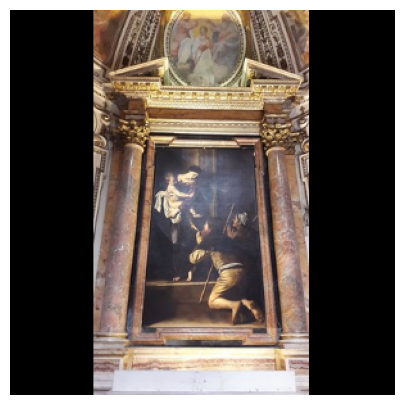

CPU times: user 99.8 ms, sys: 10.4 ms, total: 110 ms
Wall time: 35.7 ms
(1)  976 - lakeside: 0.6296380162239075
(2)  980 - valley: 0.058500420302152634
(3)  971 - alp: 0.0517805777490139
(4)  665 - monitor: 0.030769605189561844
(5)  917 - web site: 0.028704572468996048


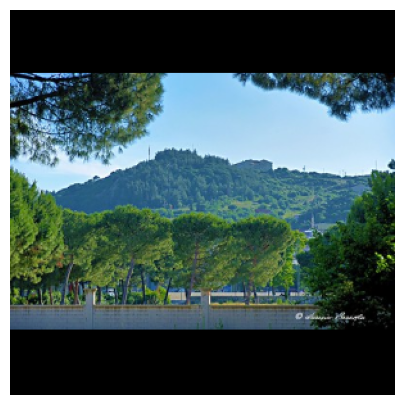

CPU times: user 92.2 ms, sys: 6.95 ms, total: 99.1 ms
Wall time: 29.9 ms
(1)  922 - book jacket: 0.1209346279501915
(2)  550 - envelope: 0.07239539921283722
(3)  459 - brass: 0.052362438291311264
(4)  836 - sundial: 0.043399617075920105
(5)  917 - web site: 0.03388885408639908


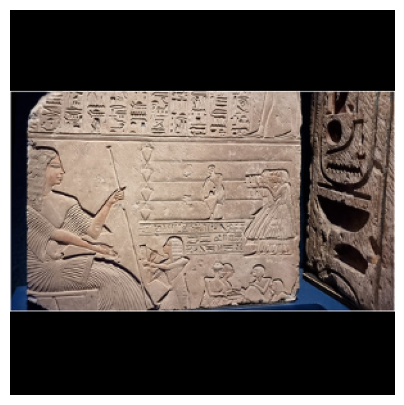

In [63]:
for image_path in image_list:
    img_url = image_path
    image, original_image = load_image(img_url, image_size, dynamic_size, max_dynamic_size)
    #show_image(image, 'Scaled image')

    # Run model on image
    %time probabilities = tf.nn.softmax(classifier(image)).numpy()

    top_5 = tf.argsort(probabilities, axis=-1, direction="DESCENDING")[0][:5].numpy()
    np_classes = np.array(classes)

    # Some models include an additional 'background' class in the predictions, so
    # we must account for this when reading the class labels.
    includes_background_class = probabilities.shape[1] == 1001

    for i, item in enumerate(top_5):
      class_index = item if includes_background_class else item + 1
      line = f'({i+1}) {class_index:4} - {classes[class_index]}: {probabilities[0][top_5][i]}'
      print(line)

    show_image(image, '')